<a href="https://colab.research.google.com/github/plaban1981/Timeseries/blob/master/Machine_learning_Assignment_usingFBProphet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

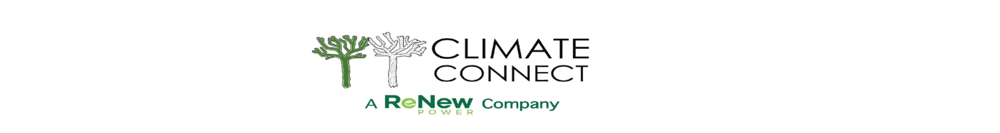

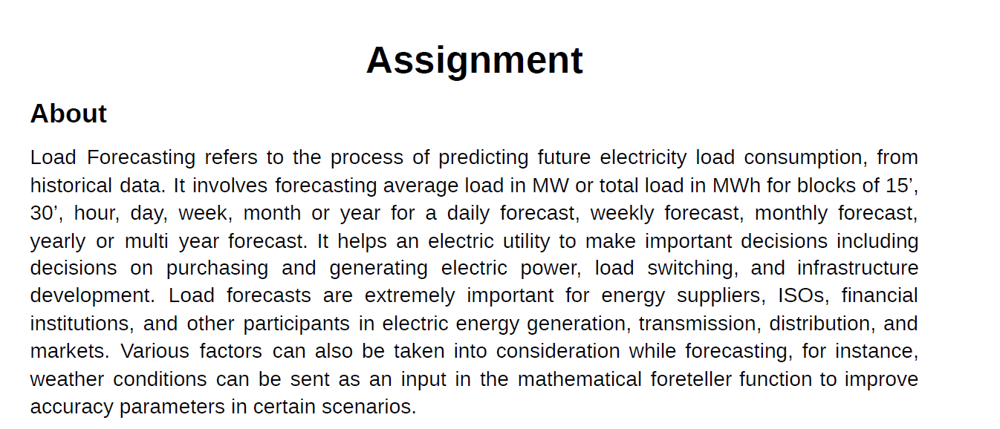

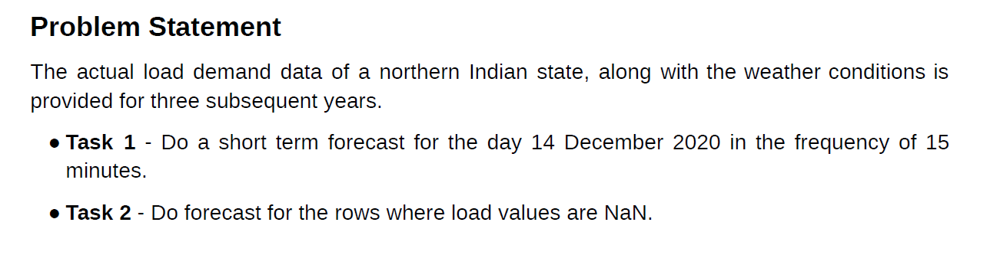

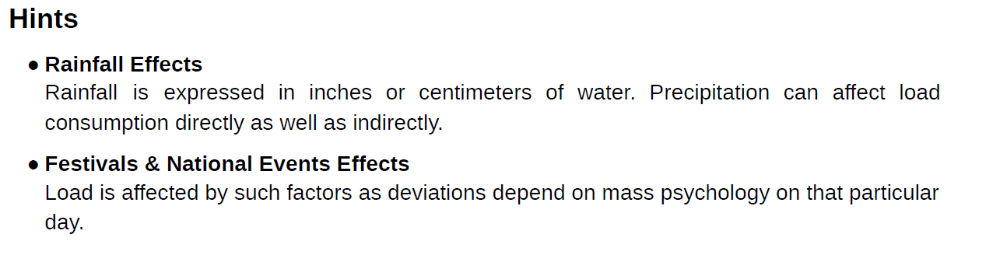

## Evaluation Metrics

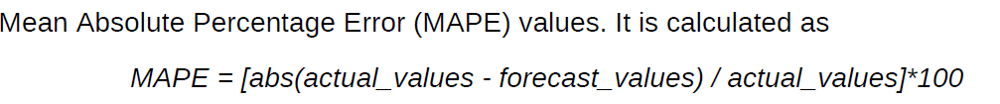

## Import Required Libraries 

In [243]:
import numpy as np
from fbprophet import Prophet
import pandas as pd
#
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
#
import os
#
from sklearn.metrics import mean_squared_error, mean_absolute_error
plt.style.use('fivethirtyeight') # For plots
#
import warnings
warnings.filterwarnings('ignore')

## Mount Drive Data

In [2]:
from google.colab import drive
drive.mount("/content/drive")


Mounted at /content/drive


## Load the data into a DataFrame

In [176]:
df = pd.read_csv("/content/drive/MyDrive/ZINDI/Assignment-MachineLearning(for candidates)/Assignment-MachineLearning/AssignmentData.csv",parse_dates =['datetime','date'])

## Schema 

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103584 entries, 0 to 103583
Data columns (total 10 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Unnamed: 0            103584 non-null  int64         
 1   datetime              103584 non-null  datetime64[ns]
 2   load                  101952 non-null  float64       
 3   apparent_temperature  103584 non-null  float64       
 4   temperature           103584 non-null  float64       
 5   humidity              103584 non-null  float64       
 6   dew_point             103584 non-null  float64       
 7   wind_speed            103584 non-null  float64       
 8   cloud_cover           103584 non-null  float64       
 9   date                  103584 non-null  datetime64[ns]
dtypes: datetime64[ns](2), float64(7), int64(1)
memory usage: 7.9 MB


In [177]:
df.shape

(103584, 10)

In [178]:
df.head()

,Unnamed: 0,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,date
0,0,2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0,2018-01-01
1,1,2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0,2018-01-01
2,2,2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0,2018-01-01
3,3,2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0,2018-01-01
4,4,2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0,2018-01-01


In [179]:
df.tail()

,Unnamed: 0,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,date
103579,103579,2020-12-14 22:45:00,NaN,12.450375,12.450375,0.611625,4.087125,1.9110,0.0000,2020-12-14
103580,103580,2020-12-14 23:00:00,NaN,12.285000,12.285000,0.619500,4.084500,1.8795,0.0000,2020-12-14
103581,103581,2020-12-14 23:15:00,NaN,13.650000,13.650000,0.829500,8.589000,2.4675,0.8925,2020-12-14
103582,103582,2020-12-14 23:30:00,NaN,13.650000,13.650000,0.829500,8.610000,2.4150,0.8925,2020-12-14
103583,103583,2020-12-14 23:45:00,NaN,13.387500,13.387500,0.840000,8.662500,2.4150,0.8610,2020-12-14


## Testing data is considered to be the data which has load as NULL values

In [180]:
test = df[df['load'].isnull()]

In [10]:
test.shape

(1632, 10)

In [11]:
df.shape

(103584, 10)

## Extract Training Data

In [232]:
train = df[~df['load'].isnull()]

In [182]:
train.shape

(101952, 10)

In [183]:
test.head()

,Unnamed: 0,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,date
48000,48000,2019-05-16 00:00:00,NaN,31.458000,31.458000,0.441000,16.56900,0.1365,0.462,2019-05-16
48001,48001,2019-05-16 00:15:00,NaN,31.371375,31.371375,0.443625,16.55325,0.1680,0.462,2019-05-16
48002,48002,2019-05-16 00:30:00,NaN,31.284750,31.284750,0.446250,16.53750,0.1995,0.462,2019-05-16
48003,48003,2019-05-16 00:45:00,NaN,31.198125,31.198125,0.448875,16.52175,0.2310,0.462,2019-05-16
48004,48004,2019-05-16 01:00:00,NaN,31.111500,31.111500,0.451500,16.50600,0.2625,0.462,2019-05-16


In [184]:
train.head()

,Unnamed: 0,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,date
0,0,2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0,2018-01-01
1,1,2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0,2018-01-01
2,2,2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0,2018-01-01
3,3,2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0,2018-01-01
4,4,2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0,2018-01-01


## Remove unwanted columns from training and test data

In [238]:
train = train.drop(['Unnamed: 0','date'],axis=1)
train.head()

,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0
1,2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0
2,2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0
3,2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0
4,2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0


In [186]:
test = test.drop(['Unnamed: 0','date','load'],axis=1).reset_index()
test.drop('index',axis=1,inplace=True)
test.head()

,datetime,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2019-05-16 00:00:00,31.458000,31.458000,0.441000,16.56900,0.1365,0.462
1,2019-05-16 00:15:00,31.371375,31.371375,0.443625,16.55325,0.1680,0.462
2,2019-05-16 00:30:00,31.284750,31.284750,0.446250,16.53750,0.1995,0.462
3,2019-05-16 00:45:00,31.198125,31.198125,0.448875,16.52175,0.2310,0.462
4,2019-05-16 01:00:00,31.111500,31.111500,0.451500,16.50600,0.2625,0.462


## Check for missing data if any in training data

In [187]:
train.isnull().sum()[train.isnull().sum() > 0]

Series([], dtype: int64)

* No missing data in the training sample

## Set Datetime as index for Timeseries plot

In [188]:
sample = train.set_index('datetime')
sample.head()

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0
2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0
2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0
2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0
2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0


In [190]:
sample.resample('H').mean().head(30)

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2018-01-01 00:00:00,755.881475,10.261125,10.261125,0.964688,8.894813,0.000000,0.000000
2018-01-01 01:00:00,683.549568,9.736125,9.736125,0.989187,8.758313,0.000000,0.000000
2018-01-01 02:00:00,644.442368,9.211125,9.211125,1.013688,8.621813,0.000000,0.000000
2018-01-01 03:00:00,643.879293,8.656594,8.749125,1.025063,8.349469,0.263813,0.000000
2018-01-01 04:00:00,667.969813,8.052844,8.392125,1.014563,7.850719,0.967313,0.000000
2018-01-01 05:00:00,795.524480,7.462875,7.771313,1.015875,7.247625,0.883312,0.000000
2018-01-01 06:00:00,1001.796023,7.457625,7.457625,1.027688,7.095375,0.011813,0.000000
2018-01-01 07:00:00,1289.855850,8.388625,8.388625,1.024188,7.984375,0.015312,0.000000
2018-01-01 08:00:00,1479.422750,9.319625,9.319625,1.020687,8.873375,0.018813,0.000000


## Visualize Training Data -reasmpling on an hourly basis

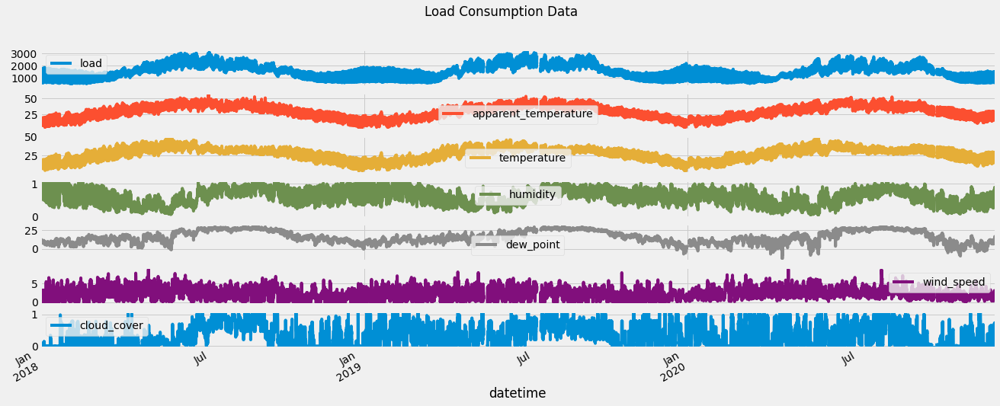

In [194]:
sample.resample('H').mean().plot(title='Load Consumption Data',figsize=(20,8),subplots=True)
plt.show()

## Visaulize the hover_data parameters having an effect on the load for a specific time span

In [195]:
fig = px.line(train,x='datetime',y='load',hover_data=['temperature','humidity'],title='Energy Load  DashBoard')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons=list([
                      dict(count=1,label="1m",step="month",stepmode="backward"),
                      dict(count=1,label="2m",step="month",stepmode="backward"),
                      dict(count=1,label="6m",step="month",stepmode="backward"),
                      dict(step="all")
        ])
    )

)

In [196]:
fig = px.line(train,x='datetime',y='load',hover_data=['dew_point','humidity'],title='Energy Load  DashBoard')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons=list([
                      dict(count=1, label="1m", step="month", stepmode="backward"),
                      dict(count=6, label="6m", step="month", stepmode="backward"),
                      dict(count=1, label="YTD", step="year", stepmode="todate"),
                      dict(count=1, label="1y", step="year", stepmode="backward"),
                      dict(step="all")
        ])
    )

)

In [197]:
fig = px.line(train,x='datetime',y='load',hover_data=['wind_speed','humidity'],title='Energy Load  DashBoard')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons=list([
                      dict(count=1, label="1m", step="month", stepmode="backward"),
                      dict(count=6, label="6m", step="month", stepmode="backward"),
                      dict(count=1, label="YTD", step="year", stepmode="todate"),
                      dict(count=1, label="1y", step="year", stepmode="backward"),
                      dict(count=2, label="2y", step="year", stepmode="backward"),
                      dict(step="all")
        ])
    )

)

## **Forecasting Load Using FB Prophet**

In [24]:
from fbprophet import Prophet

In [57]:
p = Prophet(interval_width=0.95)

In [239]:
prophet_ds = train.copy()

In [240]:
prophet_ds =prophet_ds.rename(columns={'datetime':'ds','load':'y'})
prophet_ds.head()

,ds,y,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0
1,2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0
2,2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0
3,2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0
4,2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0


In [241]:
prophet_ds.drop('apparent_temperature',axis=1,inplace=True)

In [242]:
prophet_ds.head()

,ds,y,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2018-01-01 00:00:00,803.22270,10.45800,0.955500,8.946000,0.0,0.0
1,2018-01-01 00:15:00,774.89523,10.32675,0.961625,8.911875,0.0,0.0
2,2018-01-01 00:30:00,731.46927,10.19550,0.967750,8.877750,0.0,0.0
3,2018-01-01 00:45:00,713.93870,10.06425,0.973875,8.843625,0.0,0.0
4,2018-01-01 01:00:00,699.23007,9.93300,0.980000,8.809500,0.0,0.0


In [59]:
p.add_regressor('temperature')
p.add_regressor('humidity')
p.add_regressor('dew_point')
p.add_regressor('wind_speed')
p.add_regressor('cloud_cover')

In [60]:
p.fit(prophet_ds)

In [72]:
p.params

{'beta': array([[-0.06935595, -0.1196586 ,  0.02514884,  0.05459821,  0.03608848,
          0.0261382 , -0.00590443,  0.01488301, -0.00134046, -0.00677173,
          0.00248444,  0.00297869,  0.00123858,  0.00301641, -0.00236382,
          0.00078861, -0.00441101, -0.00291691,  0.00208746,  0.0081972 ,
          0.00153549,  0.01337402, -0.00059589, -0.00961326,  0.0002855 ,
          0.00545874, -0.01694735, -0.00733727, -0.02836496,  0.01439232,
         -0.00325729,  0.00726131, -0.0030542 ,  0.00037548,  0.04023404,
         -0.0175886 ,  0.01781465, -0.00143516, -0.00276196]]),
 'delta': array([[ 5.25699622e-01,  3.16311078e-01, -1.42581920e+00,
         -4.72263901e-06, -9.22895444e-01, -1.10848574e-02,
         -3.23944899e-03,  3.21500826e+00, -1.13822909e+00,
         -5.84586134e-03,  5.57662791e-05, -1.20636440e+00,
          1.55733464e+00, -2.04246432e+00,  1.95155860e-03,
          1.94653476e-03,  1.88283631e+00, -3.47416031e+00,
          3.98632253e+00,  4.56854332e-01

In [123]:
future = p.make_future_dataframe(periods = 192,freq='15min')

In [171]:
df.tail(15)

,Unnamed: 0,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,date
103569,103569,2020-12-14 20:15:00,NaN,14.490000,14.490000,0.553875,4.486125,2.438625,0.0000,2020-12-14
103570,103570,2020-12-14 20:30:00,NaN,14.217000,14.217000,0.561750,4.425750,2.399250,0.0000,2020-12-14
103571,103571,2020-12-14 20:45:00,NaN,13.944000,13.944000,0.569625,4.365375,2.359875,0.0000,2020-12-14
103572,103572,2020-12-14 21:00:00,NaN,13.671000,13.671000,0.577500,4.305000,2.320500,0.0000,2020-12-14
103573,103573,2020-12-14 21:15:00,NaN,13.489875,13.489875,0.580125,4.252500,2.241750,0.0000,2020-12-14
103574,103574,2020-12-14 21:30:00,NaN,13.308750,13.308750,0.582750,4.200000,2.163000,0.0000,2020-12-14
103575,103575,2020-12-14 21:45:00,NaN,13.127625,13.127625,0.585375,4.147500,2.084250,0.0000,2020-12-14
103576,103576,2020-12-14 22:00:00,NaN,12.946500,12.946500,0.588000,4.095000,2.005500,0.0000,2020-12-14
103577,103577,2020-12-14 22:15:00,NaN,12.781125,12.781125,0.595875,4.092375,1.974000,0.0000,2020-12-14
103578,103578,2020-12-14 22:30:00,NaN,12.615750,12.615750,0.603750,4.089750,1.942500,0.0000,2020-12-14


In [170]:
future.tail()

,ds,temperature,humidity,dew_point,wind_speed,cloud_cover
102139,2020-12-14 22:45:00,12.450375,0.611625,4.087125,1.9110,0.0000
102140,2020-12-14 23:00:00,12.285000,0.619500,4.084500,1.8795,0.0000
102141,2020-12-14 23:15:00,13.650000,0.829500,8.589000,2.4675,0.8925
102142,2020-12-14 23:30:00,13.650000,0.829500,8.610000,2.4150,0.8925
102143,2020-12-14 23:45:00,13.387500,0.840000,8.662500,2.4150,0.8610


In [126]:
future = pd.merge(future,df,left_on ='ds',right_on='datetime',how='inner')

In [169]:
future.head()

,ds,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2018-01-01 00:00:00,10.45800,0.955500,8.946000,0.0,0.0
1,2018-01-01 00:15:00,10.32675,0.961625,8.911875,0.0,0.0
2,2018-01-01 00:30:00,10.19550,0.967750,8.877750,0.0,0.0
3,2018-01-01 00:45:00,10.06425,0.973875,8.843625,0.0,0.0
4,2018-01-01 01:00:00,9.93300,0.980000,8.809500,0.0,0.0


In [131]:
future = future.drop(['Unnamed: 0','datetime','apparent_temperature','load','date'],axis=1)

In [168]:
future.head()

,ds,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2018-01-01 00:00:00,10.45800,0.955500,8.946000,0.0,0.0
1,2018-01-01 00:15:00,10.32675,0.961625,8.911875,0.0,0.0
2,2018-01-01 00:30:00,10.19550,0.967750,8.877750,0.0,0.0
3,2018-01-01 00:45:00,10.06425,0.973875,8.843625,0.0,0.0
4,2018-01-01 01:00:00,9.93300,0.980000,8.809500,0.0,0.0


In [133]:
forecast = p.predict(future)

## Summary of the forecast made

In [167]:
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,cloud_cover,cloud_cover_lower,cloud_cover_upper,daily,daily_lower,daily_upper,dew_point,dew_point_lower,dew_point_upper,extra_regressors_additive,extra_regressors_additive_lower,extra_regressors_additive_upper,humidity,humidity_lower,humidity_upper,temperature,temperature_lower,temperature_upper,weekly,weekly_lower,weekly_upper,wind_speed,wind_speed_lower,wind_speed_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2018-01-01 00:00:00,1556.292882,640.918464,1586.830489,1556.292882,1556.292882,-453.064572,-453.064572,-453.064572,8.788308,8.788308,8.788308,47.467087,47.467087,47.467087,-50.581501,-50.581501,-50.581501,-373.186485,-373.186485,-373.186485,-85.115198,-85.115198,-85.115198,-254.520440,-254.520440,-254.520440,-66.776752,-66.776752,-66.776752,8.242346,8.242346,8.242346,-60.568422,-60.568422,-60.568422,0.0,0.0,0.0,1103.228310
1,2018-01-01 00:15:00,1556.300514,644.194829,1536.174716,1556.300514,1556.300514,-476.710731,-476.710731,-476.710731,8.788308,8.788308,8.788308,26.477985,26.477985,26.477985,-50.829301,-50.829301,-50.829301,-376.918305,-376.918305,-376.918305,-86.592237,-86.592237,-86.592237,-256.527421,-256.527421,-256.527421,-65.727818,-65.727818,-65.727818,8.242346,8.242346,8.242346,-60.542594,-60.542594,-60.542594,0.0,0.0,0.0,1079.589783
2,2018-01-01 00:30:00,1556.308147,599.350366,1543.014156,1556.308147,1556.308147,-501.521541,-501.521541,-501.521541,8.788308,8.788308,8.788308,4.310224,4.310224,4.310224,-51.077102,-51.077102,-51.077102,-380.650126,-380.650126,-380.650126,-88.069277,-88.069277,-88.069277,-258.534402,-258.534402,-258.534402,-64.664739,-64.664739,-64.664739,8.242346,8.242346,8.242346,-60.516900,-60.516900,-60.516900,0.0,0.0,0.0,1054.786606
3,2018-01-01 00:45:00,1556.315779,544.788258,1503.345965,1556.315779,1556.315779,-526.963842,-526.963842,-526.963842,8.788308,8.788308,8.788308,-18.502494,-18.502494,-18.502494,-51.324902,-51.324902,-51.324902,-384.381946,-384.381946,-384.381946,-89.546316,-89.546316,-89.546316,-260.541383,-260.541383,-260.541383,-63.588063,-63.588063,-63.588063,8.242346,8.242346,8.242346,-60.491339,-60.491339,-60.491339,0.0,0.0,0.0,1029.351937
4,2018-01-01 01:00:00,1556.323412,532.103936,1463.893701,1556.323412,1556.323412,-552.490810,-552.490810,-552.490810,8.788308,8.788308,8.788308,-41.412791,-41.412791,-41.412791,-51.572702,-51.572702,-51.572702,-388.113767,-388.113767,-388.113767,-91.023355,-91.023355,-91.023355,-262.548364,-262.548364,-262.548364,-62.498339,-62.498339,-62.498339,8.242346,8.242346,8.242346,-60.465913,-60.465913,-60.465913,0.0,0.0,0.0,1003.832602


## Selecting predictions yhat and upper and lower confidence specifying 95% confidence interval of the predictions

In [172]:
forecast[['ds','yhat_lower','yhat_upper','yhat']].tail()

,ds,yhat_lower,yhat_upper,yhat
102139,2020-12-14 22:45:00,658.812351,1600.604210,1133.603407
102140,2020-12-14 23:00:00,680.188912,1596.161556,1120.862587
102141,2020-12-14 23:15:00,616.522772,1557.209364,1086.539427
102142,2020-12-14 23:30:00,591.377826,1547.596135,1072.660975
102143,2020-12-14 23:45:00,586.434255,1501.032137,1050.612271


## **Visualizing Load Forecasting made by Prophet Model**

#### 1. Visualizing prediction overlapping with the train and forecatsed data

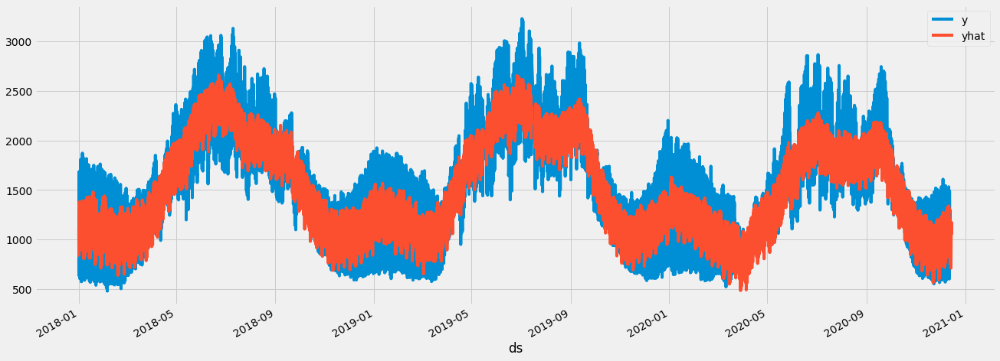

In [166]:
pd.concat([prophet_ds.set_index('ds')['y'],forecast.set_index('ds')['yhat']],axis=1).plot(figsize=(20,8))

#### 2. Visualizing Prediction Overlapping with the total training sample and that of Forecasted data

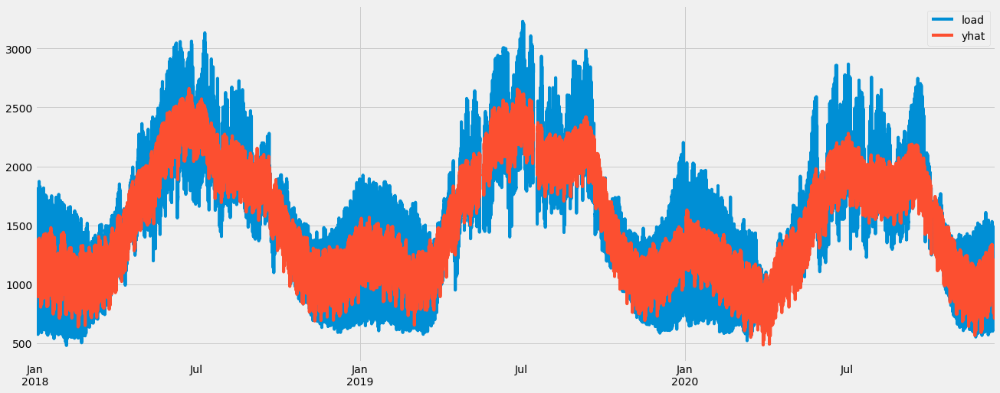

In [165]:
pd.concat([df.set_index('datetime')['load'],forecast.set_index('ds')['yhat']],axis=1).plot(figsize=(20,8))

#### 3. Visualizing forescasted data using plolty sliding window

In [164]:
fig = px.line(forecast,x='ds',y='yhat',hover_data=['dew_point','humidity'],title='Load Forecasting using Prophet')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons=list([
                      dict(count=1, label="1m", step="month", stepmode="backward"),
                      dict(count=6, label="6m", step="month", stepmode="backward"),
                      dict(count=1, label="YTD", step="year", stepmode="todate"),
                      dict(count=1, label="1y", step="year", stepmode="backward"),
                      dict(step="all")
        ])
    )

)

## Plotting the Forecast :

#### We can plot the forecast and the components by calling the Prophet.plot & Prophet.plot_components method and passing in the forecast dataframe as shown below

* The forecast plot is a single graph containing a scatter plot of historical data points indicated by black dots and the forecast/fitted curve indicated by a blue line. 
* The graph also contains a light blue shaded region which corresponds to the uncertainty bands.
* The components plot is a group of plots corresponding to various time series components(trend, seasoanilities) and external effects.
* Prophet estimates the trend and weekly_seasonality based on the training data.

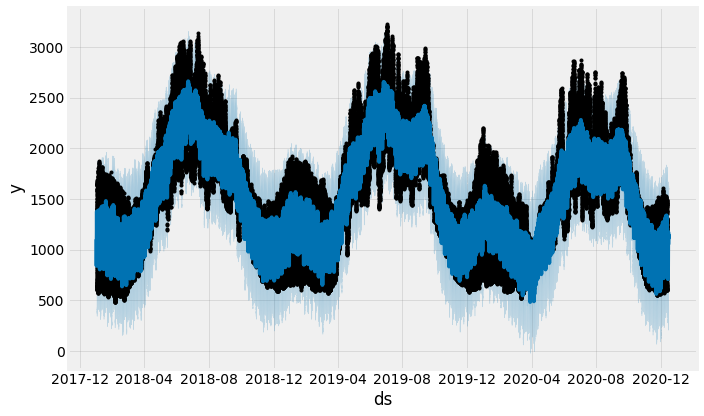

In [163]:
# Plotting the generated forecast
fig1 = p.plot(forecast, uncertainty=True)
plt.show()

## Reading Forecast Output Plot:
* X-axis represents the date values (ds ) for both history and future dates.
* Y-axis represents the target values(y, yhat)for both history and future dates.
* In the graph the black dotted points represent the historical training data points.
* The blue line represents the forecasts generated for both history and future.
* Along with there is light blue region which represents the uncertainty bands

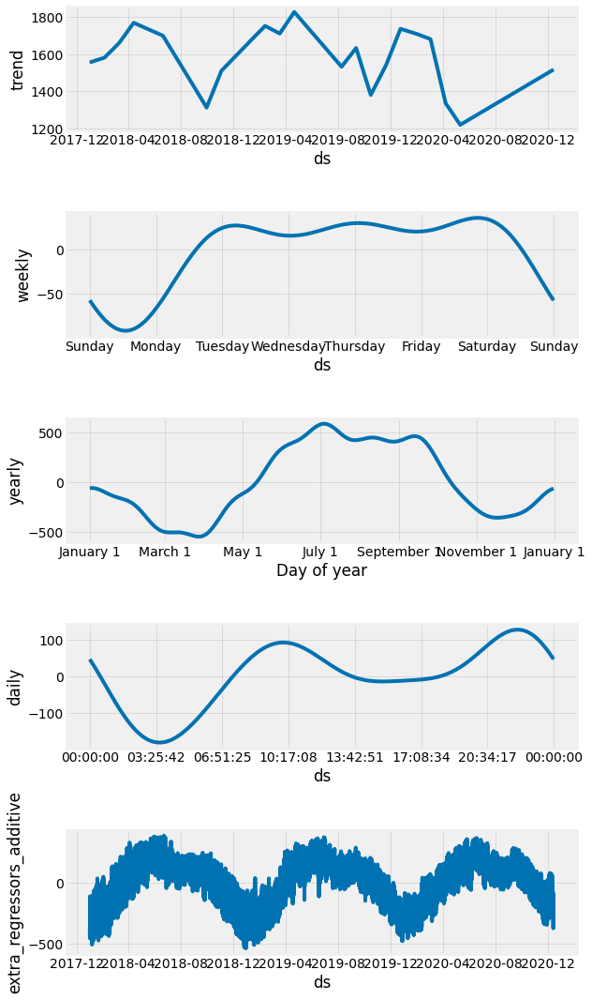

In [161]:
# Plotting the forecast components.
fig2 = p.plot_components(forecast)

## Reading Forecast Component Plot:

* X-axis represents the datetime values (ds ) for both history and future dates.
* Y-axis represents the prophet estimate for respective forecast compoent (trend, seasonality)
* Graph1: trend value for all dates(history and future).
* Graph2: weekly_seasonality a weekly profile for each day in a week based on the training data.
* Graph3: yearly_seasonality a weekly profile for each day in a week based on the training data.
* Graph4: daily_seasonality a weekly profile for each day in a week based on the training data.

## Automatic Changepoint Detection

* Prophet will automatically detect these changepoints and will allow the trend to adapt appropriately.
* Prophet specifies 19 potential changepoints which are uniformly placed in the first 80% of the time series. 
* The vertical lines in this figure indicate where the potential changepoints were placed:

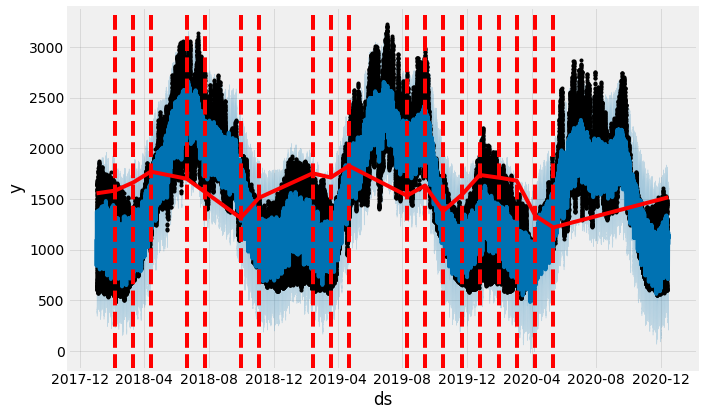

In [162]:
from fbprophet.plot import add_changepoints_to_plot
fig = p.plot(forecast)
a =add_changepoints_to_plot(fig.gca(),p,forecast)

## Dates when the change in pattern occurred for the sample data provided as deciphered by prophet

In [158]:
p.changepoints

3262    2018-02-03 23:30:00
6525    2018-03-09 23:15:00
9787    2018-04-12 22:45:00
13050   2018-05-16 22:30:00
16312   2018-06-19 22:00:00
19574   2018-07-23 21:30:00
22837   2018-08-26 21:15:00
26099   2018-09-29 20:45:00
29362   2018-11-02 20:30:00
32624   2018-12-06 20:00:00
35886   2019-01-09 19:30:00
39149   2019-02-12 19:15:00
42411   2019-03-18 18:45:00
45674   2019-04-21 18:30:00
48936   2019-05-29 18:00:00
52198   2019-07-02 17:30:00
55461   2019-08-09 17:15:00
58723   2019-09-12 16:45:00
61986   2019-10-16 16:30:00
65248   2019-11-20 16:00:00
68510   2019-12-24 15:30:00
71773   2020-01-29 15:15:00
75035   2020-03-03 14:45:00
78298   2020-04-07 14:30:00
81560   2020-05-11 14:00:00
Name: ds, dtype: datetime64[ns]

## Model Evaluation

In [222]:
eval_df = pd.merge(prophet_ds[['ds','y']],forecast[['ds','yhat']],on='ds',how='inner')
eval_df.head()

,ds,y,yhat
0,2018-01-01 00:00:00,803.22270,1103.228310
1,2018-01-01 00:15:00,774.89523,1079.589783
2,2018-01-01 00:30:00,731.46927,1054.786606
3,2018-01-01 00:45:00,713.93870,1029.351937
4,2018-01-01 01:00:00,699.23007,1003.832602


In [228]:
def mean_absolute_pervcentage_error(y_true,y_pred):
  y_true,y_pred = np.array(y_true),np.array(y_pred)
  return np.round(np.mean(np.abs((y_true - y_pred) / y_true))*100,2)

In [229]:
MAPE = mean_absolute_pervcentage_error(eval_df['y'],eval_df['yhat'])
print(f'Model Evaluation using MAPE {MAPE}%')

Model Evaluation using MAPE 13.77%


## Postprocessing data after Load Prediction

In [209]:
test = pd.merge(test,forecast[['ds','yhat_lower','yhat_upper','yhat']],left_on='datetime',right_on='ds',how='inner')

In [210]:
test.head()

,datetime,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,ds,yhat_lower,yhat_upper,yhat
0,2020-12-13 00:00:00,16.88400,16.88400,0.766500,11.718000,2.436000,0.02100,2020-12-13 00:00:00,537.003046,1507.857903,1040.300120
1,2020-12-13 00:15:00,16.72125,16.72125,0.763875,11.531625,2.533125,0.01575,2020-12-13 00:15:00,545.294252,1507.817051,1014.862851
2,2020-12-13 00:30:00,16.55850,16.55850,0.761250,11.345250,2.630250,0.01050,2020-12-13 00:30:00,505.761126,1445.488870,988.259393
3,2020-12-13 00:45:00,16.39575,16.39575,0.758625,11.158875,2.727375,0.00525,2020-12-13 00:45:00,530.239634,1437.192379,961.024015
4,2020-12-13 01:00:00,16.23300,16.23300,0.756000,10.972500,2.824500,0.00000,2020-12-13 01:00:00,462.794425,1422.486570,933.704649


In [211]:
test.drop(['ds'],axis=1,inplace=True)

In [212]:
test = test.rename(columns={'yhat':'load','yhat_lower':'lower_tolerance','yhat_upper':'upper_tolerance'})

In [213]:
test.head()

,datetime,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,lower_tolerance,upper_tolerance,load
0,2020-12-13 00:00:00,16.88400,16.88400,0.766500,11.718000,2.436000,0.02100,537.003046,1507.857903,1040.300120
1,2020-12-13 00:15:00,16.72125,16.72125,0.763875,11.531625,2.533125,0.01575,545.294252,1507.817051,1014.862851
2,2020-12-13 00:30:00,16.55850,16.55850,0.761250,11.345250,2.630250,0.01050,505.761126,1445.488870,988.259393
3,2020-12-13 00:45:00,16.39575,16.39575,0.758625,11.158875,2.727375,0.00525,530.239634,1437.192379,961.024015
4,2020-12-13 01:00:00,16.23300,16.23300,0.756000,10.972500,2.824500,0.00000,462.794425,1422.486570,933.704649


## Visualizing the load forecasted represented by red line

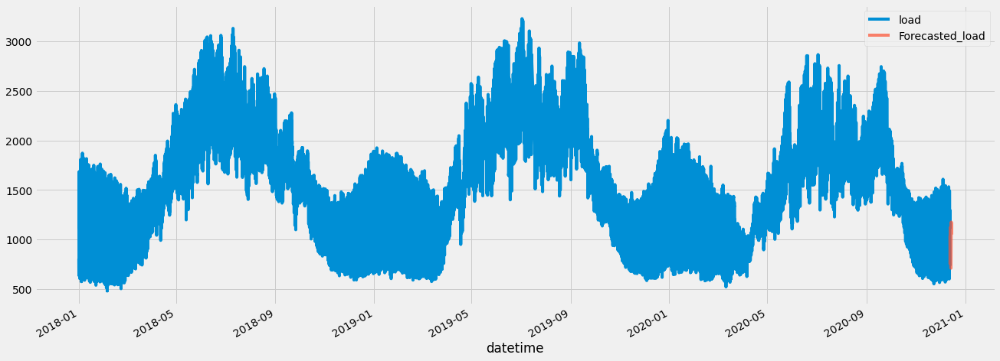

In [217]:
ax = train.set_index('datetime')[['load']].plot(figsize=(20,8))
test.set_index('datetime').rename(columns={'load':'Forecasted_load'})[['Forecasted_load']].plot(ax=ax,alpha=.7,figsize=(20,8))
plt.legend()

##Export the forecasted data to a .csv file

In [219]:
test[['datetime','load','apparent_temperature','temperature','humidity','dew_point','wind_speed','cloud_cover']].to_csv('Load_forecasted.csv',index=False)